In [1]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import os
import sys
import os
import sys

import numpy as np
import tensorflow as tf
import pandas as pd
from glob import glob
import matplotlib.pyplot as plt

import skimage
import skimage.io
%matplotlib inline

print('sys_version', sys.version.replace('\n', ''))
print('virtual_env', os.environ.get('VIRTUAL_ENV', 'None'))
print('pwd', os.getcwd())
print('np ', np.__version__)
print('tf ', tf.__version__)

# fix import src problem
sys.path.append('..')

sys_version 3.6.0 (default, Jan 16 2017, 12:12:55) [GCC 6.3.1 20170109]
virtual_env None
pwd /home/ante/git_projects/mozgalo2017/notebooks
np  1.12.1
tf  1.0.1


# Mozgalo

## Definitions

In [39]:
from src.modules.nn_utils import *
from src.modules.utils import *
from src.modules.dataset import *


DATASET_ROOT = '../dataset/mozgalo_dataset/dataset/'
csv_path = '../dataset/mozgalo_dataset/features.csv'
pickled_features_path = '../dataset/mozgalo_dataset/features_pickle'
init_logging()

In [40]:
# Loading dataset
dataset = ImageDataset(DATASET_ROOT)

# force only subset
#dataset.paths = dataset.paths[:60]
dataset.load_imgs()


2017-04-16 21:16:51 DEBUG    Loading imgs in dataset


100%|██████████| 6889/6889 [00:03<00:00, 2213.10it/s]


## Feature extraction

In [41]:
# Loading network
model = InceptionNet()
model.create_graph()

### Extracting features and dumping to file

In [20]:
# slow on cpu: cca 1-2h for 7k images
# TODO: speedup: load in batches
dataset.extract_features(model)
dataset.store_csv_features(csv_path)
dataset.store_features(pickled_features_path)

100%|██████████| 6889/6889 [1:07:31<00:00,  1.83it/s]


### Load preextracted features from last run

In [42]:
dataset.load_features(pickled_features_path)

# Data stored in dataset object

(2048,) ../dataset/mozgalo_dataset/dataset/6698.jpg


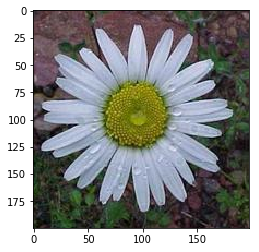

In [43]:
print(dataset.features[0].shape, dataset.paths[0])
plt.imshow(bgr_to_rgb(dataset.imgs[0]))

### Example to get labels

In [7]:
probas = model.get_probas(dataset.paths)
labels = model.get_labels(probas)

100%|██████████| 6889/6889 [27:53<00:00,  4.23it/s]


/usr/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


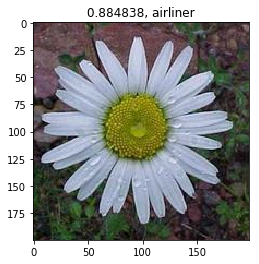

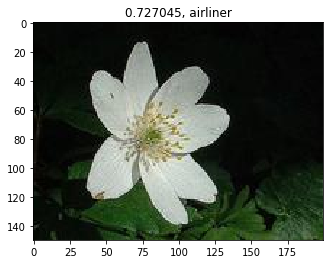

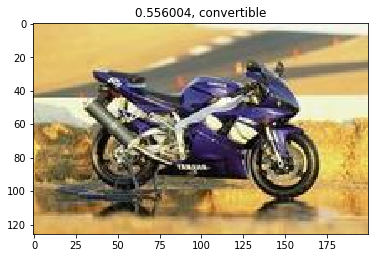

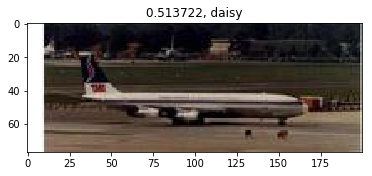

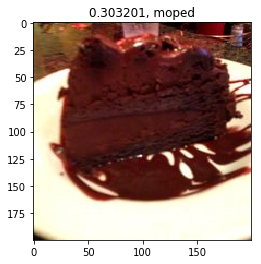

...

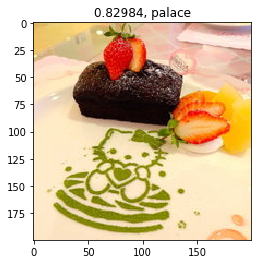

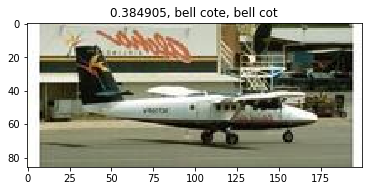

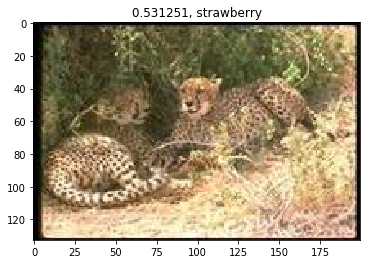

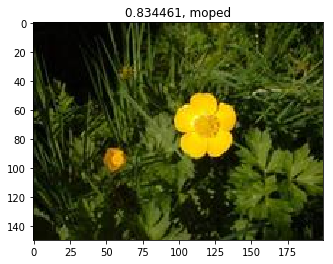

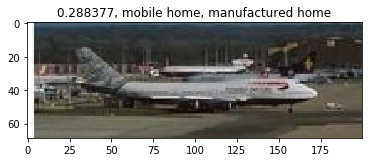

In [ ]:
for i, p in enumerate(dataset.paths):
    plt.figure()
    plt.title("%s, %s" % (probas[i].max(), labels[i]))
    plt.imshow(bgr_to_rgb(dataset.imgs[i]))

### Dummy visualisation examples

In [10]:
# Downloaded from 
# https://gist.github.com/lukemetz/be6123c7ee3b366e333a
#from tsne import bh_sne
import numpy as np
from skimage.transform import resize
from sklearn.manifold import TSNE
from matplotlib import pyplot as plt

def gray_to_color(img):
    if len(img.shape) == 2:
        img = np.dstack((img, img, img))
    return img

def min_resize(img, size):
    """
    Resize an image so that it is size along the minimum spatial dimension.
    """
    w, h = map(float, img.shape[:2])
    if min([w, h]) != size:
        if w <= h:
            img = resize(img, (int(round((h/w)*size)), int(size)))
        else:
            img = resize(img, (int(size), int(round((w/h)*size))))
    return img

def image_scatter(features, images, img_res, res=4000, cval=1.):
    """
    Embeds images via tsne into a scatter plot.
    Parameters
    ---------
    features: numpy array
        Features to visualize
    images: list or numpy array
        Corresponding images to features. Expects float images from (0,1).
    img_res: float or int
        Resolution to embed images at
    res: float or int
        Size of embedding image in pixels
    cval: float or numpy array
        Background color value
    Returns
    ------
    canvas: numpy array
        Image of visualization
    """
    features = np.copy(features).astype('float64')
    images = [gray_to_color(image) for image in images]
    images = [min_resize(image, img_res) for image in images]
    max_width = max([image.shape[0] for image in images])
    max_height = max([image.shape[1] for image in images])

    #f2d = bh_sne(features)
    model = TSNE(n_components=2, random_state=0)
    f2d = model.fit_transform(features) 

    xx = f2d[:, 0]
    yy = f2d[:, 1]
    x_min, x_max = xx.min(), xx.max()
    y_min, y_max = yy.min(), yy.max()
    # Fix the ratios
    sx = (x_max-x_min)
    sy = (y_max-y_min)
    if sx > sy:
        res_x = sx/float(sy)*res
        res_y = res
    else:
        res_x = res
        res_y = sy/float(sx)*res

    canvas = np.ones((int(res_x+max_width)+1, int(res_y+max_height)+1, 3))*cval
    x_coords = np.linspace(x_min, x_max, res_x)
    y_coords = np.linspace(y_min, y_max, res_y)
    for x, y, image in zip(xx, yy, images):
        w, h = image.shape[:2]
        x_idx = np.argmin((x - x_coords)**2)
        y_idx = np.argmin((y - y_coords)**2)
        # bgr to rgb
        canvas[x_idx:x_idx+w, y_idx:y_idx+h] = image[:,:, [2, 1, 0]]
    
    return canvas

In [11]:
canvas = image_scatter(dataset.features[:50], dataset.imgs[:50], 80, res=1000)

/usr/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/usr/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/usr/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/usr/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/usr/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 

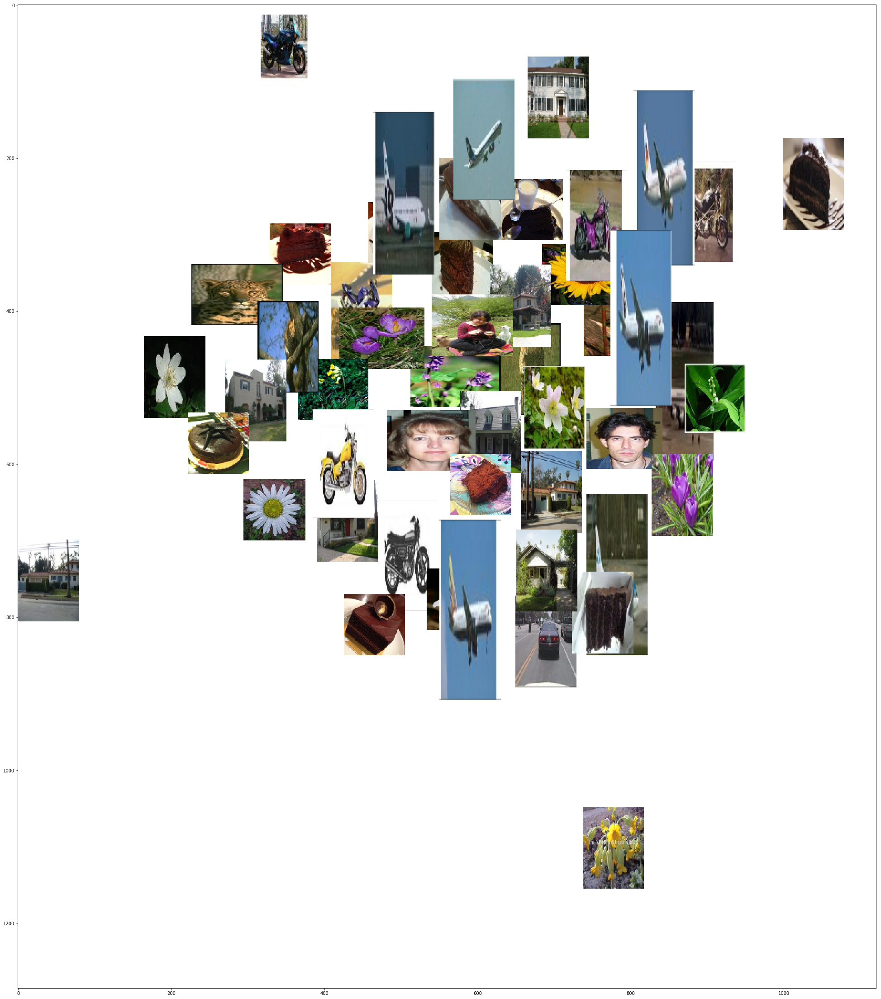

In [12]:
# ruzni prikaz, triba vodit racuna o dimenzijama
plt.figure(figsize=(40,40))
plt.imshow(canvas)

# Clustering scores

In [7]:
from src.modules.clustering_scores import *

Jako dug primjer cca 2h


Selecting number of clusters on toy datasets

This example shows several algorithms to choose the number of clusters,
for a particular clustering algorithm on a particular dataset. It mainly
illustrates that some algorithms are faster, some algorithms only understand
convex clusters (first dataset) and some algorithms understand non-convex
clusters (second and third datasets).

The running times only give intuition of which algorithm is faster. Running time
highly depends on a datasets number of samples and number of features.



/usr/lib/python3.6/site-packages/sklearn/manifold/spectral_embedding_.py:229: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"
/usr/lib/python3.6/site-packages/sklearn/manifold/spectral_embedding_.py:229: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"
/usr/lib/python3.6/site-packages/sklearn/manifold/spectral_embedding_.py:229: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"
/usr/lib/python3.6/site-packages/sklearn/manifold/spectral_embedding_.py:229: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"
/usr/lib/python3.6/site-packages/sklearn/manifold/spectral_embedding

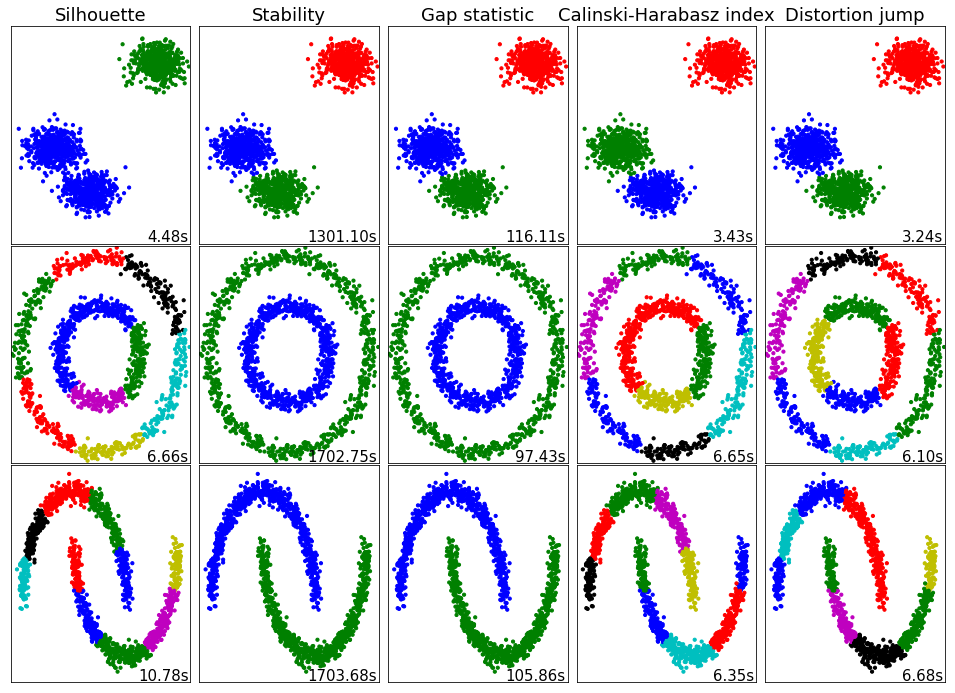

In [22]:
"""
============================================
Selecting number of clusters on toy datasets
============================================

This example shows several algorithms to choose the number of clusters,
for a particular clustering algorithm on a particular dataset. It mainly
illustrates that some algorithms are faster, some algorithms only understand
convex clusters (first dataset) and some algorithms understand non-convex
clusters (second and third datasets).

The running times only give intuition of which algorithm is faster. Running time
highly depends on a datasets number of samples and number of features.
"""
print(__doc__)

import time
from operator import itemgetter

import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster.spectral import SpectralClustering
from sklearn.datasets import make_blobs, make_moons, make_circles
from sklearn.preprocessing import StandardScaler

n_samples = 1500
seed = 1
datasets = [
    make_blobs(n_samples=n_samples, random_state=seed),
    make_circles(n_samples=n_samples, factor=.5, noise=.05, shuffle=True, random_state=seed),
    make_moons(n_samples=n_samples, noise=.05, shuffle=True, random_state=seed),
]

cluster_estimator = SpectralClustering(eigen_solver='arpack', affinity="nearest_neighbors")

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k']
nb_colors = len(colors)

plt.figure(figsize=(13, 9.5))
plt.subplots_adjust(left=.001, right=.999, bottom=.001, top=.96, wspace=.05,
                    hspace=.01)

plot_num = 1
printed_header = False

for dataset in datasets:
    X, true_labels = dataset
    # normalize dataset for nicer plotting
    X = StandardScaler().fit_transform(X)

    for name, func_choose_nb_cluster in {
            'Silhouette': max_silhouette,
            'Stability': stability,
            'Gap statistic': gap_statistic,
            'Calinski-Harabasz index': max_CH_index,
            'Distortion jump': distortion_jump,
    }.items():
        # predict cluster memberships
        t0 = time.time()
        nb_cluster, k_score = func_choose_nb_cluster(X, cluster_estimator, k_max=10)
        t1 = time.time()

        # retrieving clustering done
        cluster_estimator.set_params(n_clusters=nb_cluster)
        y_pred = cluster_estimator.fit_predict(X)

        # plot
        plt.subplot(3, 5, plot_num)
        if not printed_header:
            plt.title(name, size=18)
        points_color = [colors[y % nb_colors] for y in y_pred]
        plt.scatter(X[:, 0], X[:, 1], color=points_color, s=10)

        plt.xlim(-2, 2)
        plt.ylim(-2, 2)
        plt.xticks(())
        plt.yticks(())
        plt.text(.99, .01, ('%.2fs' % (t1 - t0)).lstrip('0'),
                 transform=plt.gca().transAxes, size=15,
                 horizontalalignment='right')
        plot_num += 1
    printed_header = True

plt.show()

/usr/lib/python3.6/site-packages/sklearn/manifold/spectral_embedding_.py:229: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"
/usr/lib/python3.6/site-packages/sklearn/manifold/spectral_embedding_.py:229: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"
/usr/lib/python3.6/site-packages/sklearn/manifold/spectral_embedding_.py:229: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"
/usr/lib/python3.6/site-packages/sklearn/manifold/spectral_embedding_.py:229: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"
/usr/lib/python3.6/site-packages/sklearn/manifold/spectral_embedding

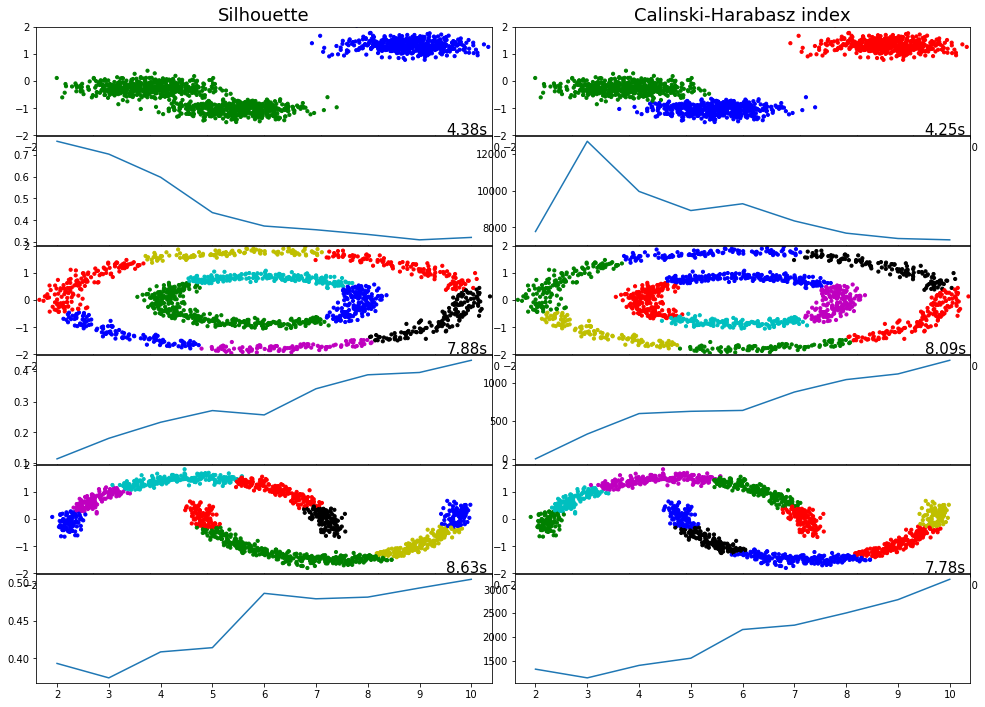

In [6]:
import time
from operator import itemgetter
import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster.spectral import SpectralClustering
from sklearn.datasets import make_blobs, make_moons, make_circles
from sklearn.preprocessing import StandardScaler

n_samples = 1500
seed = 1
datasets = [
    make_blobs(n_samples=n_samples, random_state=seed),
    make_circles(n_samples=n_samples, factor=.5, noise=.05, shuffle=True, random_state=seed),
    make_moons(n_samples=n_samples, noise=.05, shuffle=True, random_state=seed),
]

cluster_estimator = SpectralClustering(eigen_solver='arpack', affinity="nearest_neighbors")

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k']
nb_colors = len(colors)

plt.figure(figsize=(13, 9.5))
plt.subplots_adjust(left=.001, right=.999, bottom=.001, top=.96, wspace=.05,
                    hspace=.01)

plot_num = 1
printed_header = False

for dataset in datasets:
    X, true_labels = dataset
    # normalize dataset for nicer plotting
    X = StandardScaler().fit_transform(X)

    for name, func_choose_nb_cluster in {
            'Silhouette': max_silhouette,
            'Calinski-Harabasz index': max_CH_index,
    }.items():
        # predict cluster memberships
        t0 = time.time()
        nb_cluster, k_score = func_choose_nb_cluster(X, cluster_estimator, k_max=10)
        t1 = time.time()

        # retrieving clustering done
        cluster_estimator.set_params(n_clusters=nb_cluster)
        y_pred = cluster_estimator.fit_predict(X)

        # plot
        plt.subplot(6, 2, plot_num)
        if not printed_header:
            plt.title(name, size=18)
        points_color = [colors[y % nb_colors] for y in y_pred]
        plt.scatter(X[:, 0], X[:, 1], color=points_color, s=10)

        plt.xlim(-2, 2)
        plt.ylim(-2, 2)
        #plt.xticks(())
        #plt.yticks(())
        plt.text(.99, .01, ('%.2fs' % (t1 - t0)).lstrip('0'),
                 transform=plt.gca().transAxes, size=15,
                 horizontalalignment='right')
        plt.subplot(6, 2, plot_num + 2)
        plt.plot(k_score[:,0], k_score[:,1])
        plot_num += 1
    printed_header = True
    plot_num += 2

plt.show()

In [7]:
dataset.paths

['../dataset/mozgalo_dataset/dataset/6698.jpg',
 '../dataset/mozgalo_dataset/dataset/1008.jpg',
 '../dataset/mozgalo_dataset/dataset/2660.jpg',
 '../dataset/mozgalo_dataset/dataset/0602.jpg',
 '../dataset/mozgalo_dataset/dataset/0543.jpg',
 '../dataset/mozgalo_dataset/dataset/0149.jpg',
 '../dataset/mozgalo_dataset/dataset/4835.jpg',
 '../dataset/mozgalo_dataset/dataset/5856.jpg',
 '../dataset/mozgalo_dataset/dataset/2554.jpg',
 '../dataset/mozgalo_dataset/dataset/3665.jpg',
 '../dataset/mozgalo_dataset/dataset/6667.jpg',
 '../dataset/mozgalo_dataset/dataset/4275.jpg',
 '../dataset/mozgalo_dataset/dataset/6042.jpg',
 '../dataset/mozgalo_dataset/dataset/6394.jpg',
 '../dataset/mozgalo_dataset/dataset/2986.jpg',
 '../dataset/mozgalo_dataset/dataset/5740.jpg',
 '../dataset/mozgalo_dataset/dataset/5285.jpg',
 '../dataset/mozgalo_dataset/dataset/5446.jpg',
 '../dataset/mozgalo_dataset/dataset/4653.jpg',
 '../dataset/mozgalo_dataset/dataset/1513.jpg',
 '../dataset/mozgalo_dataset/dataset/257

In [8]:
os.path.basename(dataset.paths[0])

'6698.jpg'

In [9]:
cv2.imwrite(os.path.basename(dataset.paths[0]), dataset.imgs[0])

True

In [10]:
labels = [0,0,0,0,1,1,1,1,2,3,4,5,7,8]

In [11]:
# root dir for clusters ( dir/0/imgs, dir/1/imgs, ... ), labels need to be np.array 1D 
dataset.save_cluset_to_file('./clusers/', np.array(labels))

100%|██████████| 8/8 [00:00<00:00, 1220.34it/s]


# Clustering test

In [11]:
from sklearn.cluster.spectral import SpectralClustering
from sklearn.cluster import KMeans
from src.modules.clustering_scores import *

cluster_estimator = KMeans(n_jobs=-1)

func_choose_nb_cluster = max_silhouette

nb_cluster, k_score = func_choose_nb_cluster(dataset.features, cluster_estimator, k_max=15)

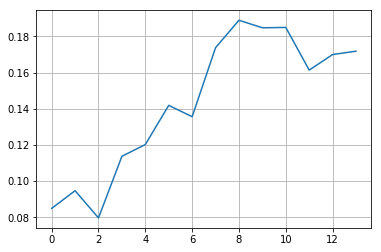

In [16]:
plt.plot(k_score[:,1])
plt.grid()

In [15]:
nb_cluster

10

In [52]:
#posto cv ne moze spremiti gif izbacujem gif iz skupa
del dataset.paths[6649]
X = np.delete(dataset.features, 6649, 0)


model = KMeans(n_clusters=nb_cluster)
model.fit(X)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=10, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [53]:
dataset.save_cluset_to_file('./clusters', model.labels_)

100%|██████████| 10/10 [00:02<00:00,  2.85it/s]
